In [41]:
###########################################################
###   Train an Auto Damage Image Authentication Model   ###
###########################################################

###################
### Credentials ###
###################

import os
import sys
from pathlib import Path

filepath = input("file path to credentials: ")
sys.path.append(filepath)
from credentials import hostname, protocol, token, token_pem

In [ ]:
#############################
### Connect with SAS Viya ###
#############################

import swat

access_token = open(token, "r").read()
conn =  swat.CAS(hostname=hostname, username=None, password=access_token, ssl_ca_list=token_pem, protocol=protocol)
conn
#print(conn.serverstatus())

NOTE: Grid node action status report: 1 nodes, 9 total actions executed.
[About]

 {'CAS': 'Cloud Analytic Services',
  'CASCacheLocation': 'CAS Disk Cache',
  'CASHostAccountRequired': 'OPTIONAL',
  'Copyright': 'Copyright © 2014-2025 SAS Institute Inc. All Rights Reserved.',
  'GlobalReadOnlyMode': 'NO',
  'ServerTime': '2025-09-23T14:12:52Z',
  'System': {'Hostname': 'controller.sas-cas-server-default.innovationlab.svc.cluster.local',
   'Linux Distribution': 'Red Hat Enterprise Linux release 8.10 (Ootpa)',
   'Model Number': 'x86_64',
   'OS Family': 'LIN X64',
   'OS Name': 'Linux',
   'OS Release': '5.15.0-1090-azure',
   'OS Version': '#99-Ubuntu SMP Thu May 22 21:15:50 UTC 2025'},
  'Transferred': 'NO',
  'Version': '4.00',
  'VersionLong': 'V.04.00M0P08112025',
  'Viya Release': '20250919.1758271571430',
  'Viya Version': 'Stable 2025.08',
  'license': {'expires': '25Sep2027:00:00:00',
   'gracePeriod': 0,
   'site': 'CIS CREATE INNOVATION LAB -RISK-MRM-SPIF-AIDER-MAR',
   'si

In [43]:
### import actions for modeling
conn.loadactionset('image')
conn.loadactionset('sampling')
conn.loadactionset('deepLearn')
conn.loadactionset('simple')
conn.loadactionset('table')

NOTE: Added action set 'image'.
NOTE: Added action set 'sampling'.
NOTE: Added action set 'deepLearn'.
NOTE: Added action set 'simple'.
NOTE: Added action set 'table'.


[actionset]

 'table'

+ Elapsed: 0.000316s, user: 0.000189s, sys: 9.2e-05s, mem: 0.222mb

In [44]:
### define names of caslibs and tables
caslib_images = 'images'
caslib_output = 'public'
caslib_models = 'casuser'
table_images = 'auto_claim_images'
table_images_r = 'auto_claim_images_resized'
table_images_rs = 'auto_claim_images_shuffled'
table_images_rsp = 'auto_claim_images_partitioned'
table_images_rspa = 'auto_claim_images_augmented'
table_scored = 'auto_claim_images_scored'
table_astore = 'auto_claim_images_astore'

In [45]:
### assign caslib to directory where images reside (set subDirectories=True if multiple directories)
### caslib is required to load images into CAS table
### images could be in Github (on SAS Server in Viya) or a path to a file system
imagepath = input("file path within viya to Github directory with images: ")

conn.table.addCaslib(
        name=caslib_images,
		description='',
        session=True,
		path=imagepath,
        subDirectories=True,
        datasource=dict(srctype="path")
)

NOTE: 'images' is now the active caslib.
NOTE: Cloud Analytic Services added the caslib 'images'.


,Name,Type,Description,Path,Definition,Subdirs,Local,Active,Personal,Hidden,Transient,TableRedistUpPolicy
0,images,PATH,,/innovationlab-export/innovationlab/homes/Chri...,,1.0,1.0,1.0,0.0,0.0,0.0,Not Specified


In [46]:
### load images into CAS table
### images are labeled based on directory names
auto_claim_images = conn.image.loadimages(
    caslib=caslib_images,
    recurse=True,
    labelLevels=-1,
    addColumns=("CHANNELCOUNT", "CHANNELTYPE", "DEPTH", "HEIGHT", "ORIENTATION", "POSITION", "SPACING", "SPAN", "WIDTH"),
    casOut=dict(caslib=caslib_output, name=table_images, replace=True)
)

NOTE: Loaded 344 images from /innovationlab-export/innovationlab/homes/Chris.Parrish@sas.com/chris_git/data/images/auto_damage/ into table auto_claim_images.


In [47]:
conn.simple.freq(
    table=dict(caslib=caslib_output, name=table_images, vars='_label_')
)

,Column,CharVar,FmtVar,Level,Frequency
0,_label_,ai_damage,ai_damage,1,41.0
1,_label_,no_damage,no_damage,2,170.0
2,_label_,real_damage,real_damage,3,133.0


In [48]:
### drop 'no_damage' images
conn.table.deleteRows(
    table=dict(caslib=caslib_output, name=table_images, where="_label_='no_damage'")
)

[rowsDeleted]

 170

+ Elapsed: 0.0034s, user: 0.0106s, sys: 0.000666s, mem: 2.22mb

In [49]:
conn.table.shuffle(
    table=dict(caslib=caslib_output, name=table_images),
    casout=dict(caslib=caslib_output, name=table_images, replace=True)
)

[caslib]

 'Public'

[tableName]

 'AUTO_CLAIM_IMAGES'

[casTable]

 CASTable('AUTO_CLAIM_IMAGES', caslib='Public')

+ Elapsed: 1.99s, user: 0.62s, sys: 2.1s, mem: 1.58e+03mb

In [50]:
### fetch n images to view
view_images = conn.image.fetchImages(
    table=dict(caslib=caslib_output, name=table_images),
    to=5, seed=12345
)
print(view_images)

NOTE: The table AUTO_CLAIM_IMAGES contains encoded images.
[Images]

                                                Image   Width  Height        Label
 0  b'\x89PNG\r\n\x1a\n\x00\x00\x00\rIHDR\x00\x00\...  1536.0  1024.0    ai_damage
 1  b'\xff\xd8\xff\xe0\x00\x14JFIF\x00\x01\x01\x01...  4032.0  3024.0  real_damage
 2  b'\x89PNG\r\n\x1a\n\x00\x00\x00\rIHDR\x00\x00\...  1024.0  1536.0    ai_damage
 3  b'\xff\xd8\xff\xe0\x00\x14JFIF\x00\x01\x01\x01...  4032.0  3024.0  real_damage
 4  b'\xff\xd8\xff\xe0\x00\x14JFIF\x00\x01\x01\x01...  4032.0  3024.0  real_damage

+ Elapsed: 1.19s, user: 1.11s, sys: 0.0764s, mem: 173mb


In [51]:
### CAS returns results in single column with each row/image as a dictionary within one column, so need to pull out the dictionaries from the column into a single row in a dataframe
### need to ensure that column names align with results
import pandas as pd
sample_images = pd.DataFrame(view_images["Images"]).apply(pd.Series).set_axis(['image', 'width', 'height', 'label'], axis=1)

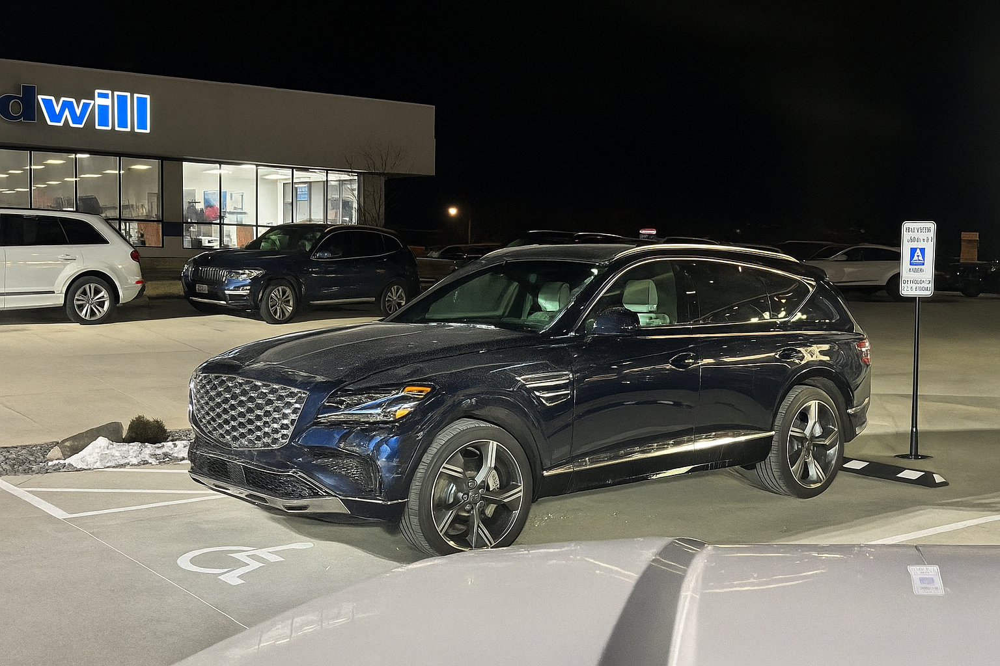

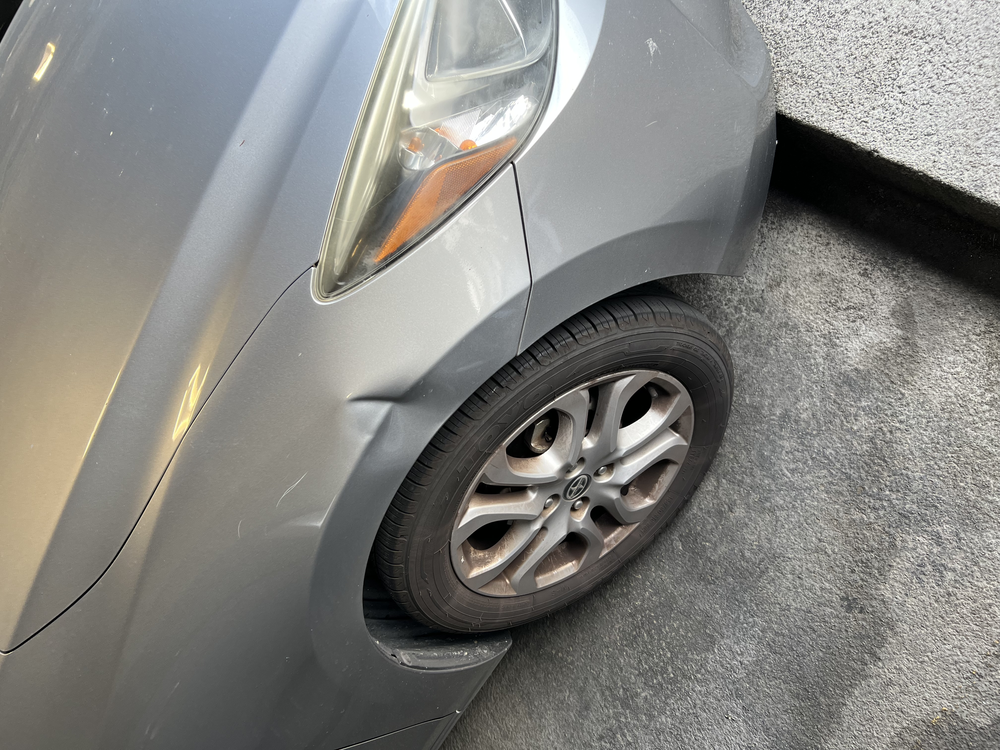

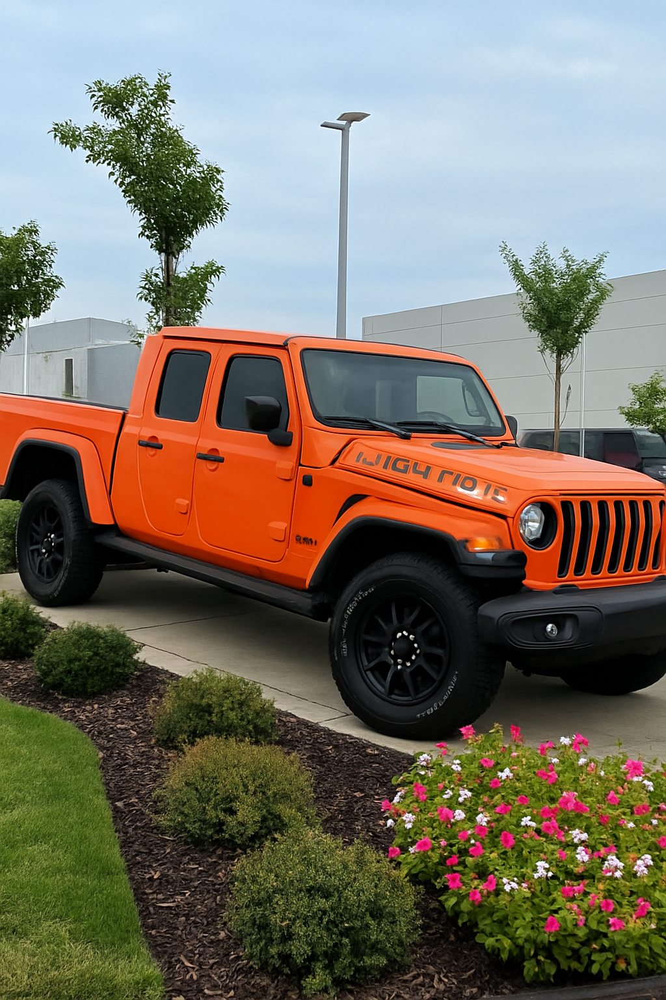

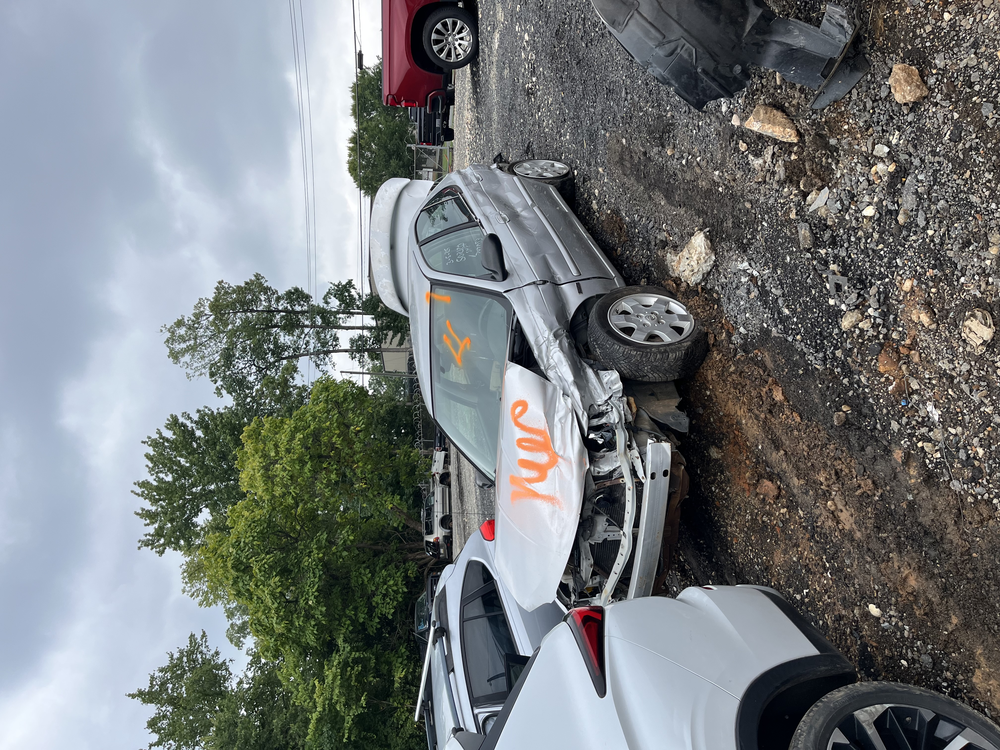

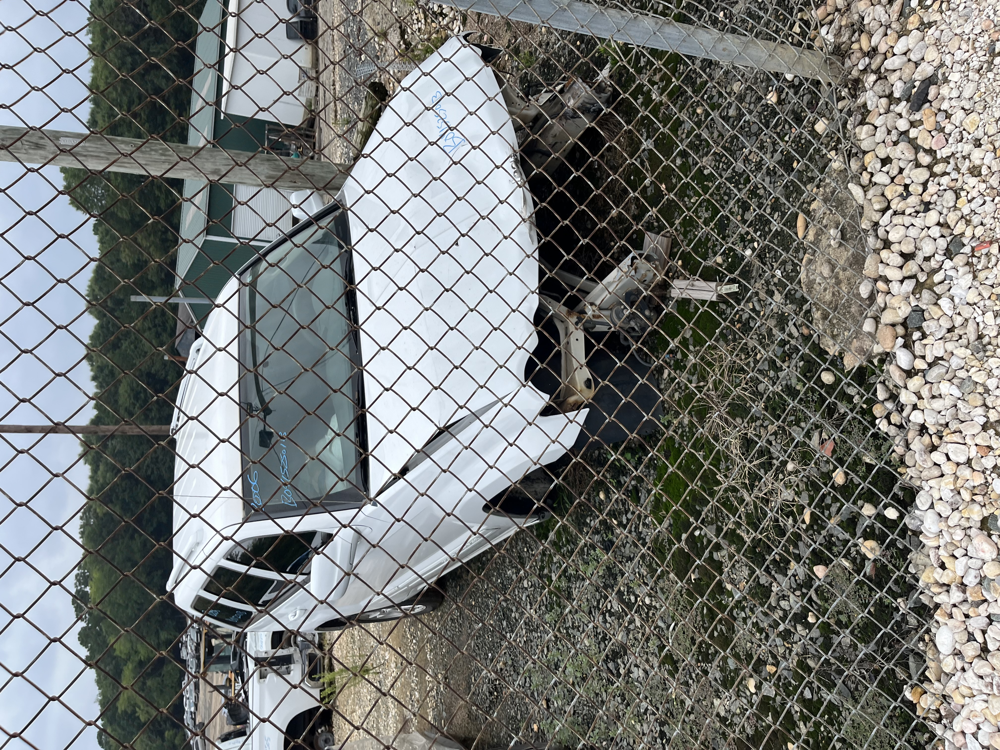

In [56]:
### display images by looping through function
from IPython.display import Image, display

num_images_to_view = len(sample_images) # or just enter to integer 
for i in range(num_images_to_view):
    image_bytes = sample_images['image'].iloc[i]
    display(Image(data=image_bytes))

In [57]:
conn.image.summarizeImages(
    table=dict(caslib=caslib_output, name=table_images)
)

NOTE: The table AUTO_CLAIM_IMAGES contains encoded images.
NOTE: 174 out of 174 images were scanned and results were saved to the summary table.


,Column,jpg,png,minWidth,maxWidth,minHeight,maxHeight,meanWidth,meanHeight,mean1stChannel,min1stChannel,max1stChannel,mean2ndChannel,min2ndChannel,max2ndChannel,mean3rdChannel,min3rdChannel,max3rdChannel
0,_image_,137.0,37.0,864.0,4032.0,940.0,3024.0,3266.304598,2574.87931,117.368285,0.0,255.0,118.234318,0.0,255.0,116.810017,0.0,255.0


In [58]:
### resize images to match model requirements
conn.image.processimages(
    table=dict(caslib=caslib_output, name=table_images),
    casout=dict(caslib=caslib_output, name=table_images_r, replace=True),
    steps=[dict(step=dict(stepType='RESIZE', type='BASIC', width=224, height=224))]
)

NOTE: The table AUTO_CLAIM_IMAGES contains encoded images.
NOTE: 174 of 174 images were processed successfully and saved as encoded images to the table auto_claim_images_resized.


,casLib,Name,Rows,Columns,casTable
0,Public,auto_claim_images_resized,174,6,"CASTable('auto_claim_images_resized', caslib='..."


In [59]:
### shuffle images to mix image labels
conn.table.shuffle(
    table=dict(caslib=caslib_output, name=table_images_r),
    casout=dict(caslib=caslib_output, name=table_images_rs, replace=True)
)

[caslib]

 'Public'

[tableName]

 'AUTO_CLAIM_IMAGES_SHUFFLED'

[casTable]

 CASTable('AUTO_CLAIM_IMAGES_SHUFFLED', caslib='Public')

+ Elapsed: 0.0162s, user: 0.0138s, sys: 0.017s, mem: 95.9mb

In [60]:
### partition image dataset for training/testing
conn.sampling.srs(
    table=dict(caslib=caslib_output, name=table_images_rs),
    output=dict(casOut=dict(caslib=caslib_output, name=table_images_rsp, replace=True), copyVars="ALL"),
    sampPct=70, partInd=True, seed=12345
)
conn.simple.freq(
    table=dict(caslib=caslib_output, name=table_images_rsp, vars="_partInd_")
)

NOTE: Simple Random Sampling is in effect.
NOTE: Using SEED=12345 for sampling.


,Column,NumVar,FmtVar,Level,Frequency
0,_PartInd_,0.0,0,1,52.0
1,_PartInd_,1.0,1,2,122.0


In [61]:
conn.table.columnInfo(
    table=dict(caslib=caslib_output, name=table_images_rsp)
)

,Column,Label,ID,Type,RawLength,FormattedLength,Format,NFL,NFD
0,_image_,,1,varbinary(image),125386,125386,,0,0
1,_size_,,2,int64,8,20,,0,0
2,_label_,,3,varchar,11,11,,0,0
3,_id_,,4,int64,8,20,,0,0
4,_path_,,5,varchar,148,148,,0,0
5,_type_,,6,char,3,3,,0,0
6,_PartInd_,Partition Indicator,7,double,8,12,,0,0


In [ ]:
### creates subregions (patches) of images and then resizes them to match the rest of the images
### starts at (0,0) point, patches of 200x200 are created in each step, sweeping across entire image, and adjusted to 224x224 at the end
conn.image.augmentImages(
    table=dict(caslib=caslib_output, name=table_images_rsp, where="_PartInd_=1"),
    casout=dict(caslib=caslib_output, name=table_images_rspa, replace=True),
    seed=12345,
    augmentations=[
        dict(x=0, y=0, width=200, height=200, stepsize=24, sweepImage=True, outputWidth=224, outputHeight=224)
    ]
)

NOTE: The table AUTO_CLAIM_IMAGES_PARTITIONED contains encoded images.
NOTE: Out of 122 input images, 488 images were successfully produced and saved as encoded images to the table auto_claim_images_augmented.


,casLib,Name,Rows,Columns,casTable
0,Public,auto_claim_images_augmented,488,7,"CASTable('auto_claim_images_augmented', caslib..."


In [63]:
conn.simple.freq(
    table=dict(caslib=caslib_output, name=table_images_rspa, vars="_label_")
)

,Column,CharVar,FmtVar,Level,Frequency
0,_label_,ai_damage,ai_damage,1,120.0
1,_label_,real_damage,real_damage,2,368.0


In [64]:
conn.table.columnInfo(
    table=dict(caslib=caslib_output, name=table_images_rspa)
)

,Column,Label,ID,Type,RawLength,FormattedLength,Format,NFL,NFD
0,_image_,,1,varbinary(image),114895,114895,,0,0
1,_size_,,2,int64,8,20,,0,0
2,_path_,,3,varchar,148,148,,0,0
3,_type_,,4,char,3,3,,0,0
4,_id_,,5,int64,8,20,,0,0
5,_parentId_,,6,int64,8,20,,0,0
6,_label_,,7,varchar,11,11,,0,0


In [65]:
### defining caslibs and datasets with pre-trained model (case sensitive in Python)
table_images_train = table_images_rspa
trained_model = 'RESNET50_CAFFE'
initial_weights = 'RESNET50_CAFFE_WEIGHTS'
model_weights = 'RESNET50_CAFFE_WEIGHTS_STORE'
trained_model_path = 'RESNET50_CAFFE.sashdat'
initial_weights_path = 'RESNET50_CAFFE_WEIGHTS.sashdat'
model_weights_path = 'RESNET50_CAFFE_WEIGHTS_ATTR.sashdat'

In [66]:
### load table in-memory if not already exists in-memory (case sensitive in Python)
if conn.table.tableExists(caslib=caslib_models, name=trained_model).exists<=0:
    conn.table.loadTable(caslib=caslib_models, path=trained_model_path, 
                         casout=dict(caslib=caslib_output, name=trained_model, promote=True)
    )

if conn.table.tableExists(caslib=caslib_models, name=initial_weights).exists<=0:
    conn.table.loadTable(caslib=caslib_models, path=initial_weights_path, 
                         casout=dict(caslib=caslib_output, name=initial_weights, promote=True)
    )

if conn.table.tableExists(caslib=caslib_models, name=model_weights).exists<=0:
    conn.table.loadTable(caslib=caslib_models, path=model_weights_path, 
                         casout=dict(caslib=caslib_output, name=model_weights, promote=True)
    )

ERROR: The table RESNET50_CAFFE already exists in caslib public.
ERROR: The action stopped due to errors.
ERROR: The table RESNET50_CAFFE_WEIGHTS already exists in caslib public.
ERROR: The action stopped due to errors.
ERROR: The table RESNET50_CAFFE_WEIGHTS_STORE already exists in caslib public.
ERROR: The action stopped due to errors.


In [67]:
### load pre-trained model into a CAS table
conn.table.loadTable(
    caslib=caslib_models, path=trained_model_path,
    casout=dict(caslib=caslib_output, name=trained_model)
)
conn.table.loadTable(
    caslib=caslib_models, path=initial_weights_path,
    casout=dict(caslib=caslib_output, name=initial_weights)
)
conn.table.loadTable(
    caslib=caslib_models, path=model_weights_path,
    casout=dict(caslib=caslib_output, name=model_weights)
)

NOTE: Cloud Analytic Services made the file RESNET50_CAFFE.sashdat available as table RESNET50_CAFFE in caslib public.
NOTE: Cloud Analytic Services made the file RESNET50_CAFFE_WEIGHTS.sashdat available as table RESNET50_CAFFE_WEIGHTS in caslib public.
NOTE: Cloud Analytic Services made the file RESNET50_CAFFE_WEIGHTS_ATTR.sashdat available as table RESNET50_CAFFE_WEIGHTS_STORE in caslib public.


[caslib]

 'public'

[tableName]

 'RESNET50_CAFFE_WEIGHTS_STORE'

[casTable]

 CASTable('RESNET50_CAFFE_WEIGHTS_STORE', caslib='public')

+ Elapsed: 0.00408s, user: 0.000692s, sys: 0.000332s, mem: 0.731mb

In [68]:
### remove output layer since this only has 2 labels (not 1000 as with the trained model)
conn.deepLearn.removeLayer(
    modelTable=dict(caslib=caslib_output, name=trained_model),
    name='fc1000'
)
conn.deepLearn.addLayer(
    model=dict(caslib=caslib_output, name=trained_model),
    name='fc2',
    layer=dict(type='output', n=2, act='softmax'),
    srcLayers='pool5'
)

,casLib,Name,Rows,Columns,casTable
0,Public,resnet50_caffe,1354,5,"CASTable('resnet50_caffe', caslib='Public')"


In [69]:
conn.table.columnInfo(
    table=dict(caslib=caslib_output, name=table_images_train)
)

,Column,Label,ID,Type,RawLength,FormattedLength,Format,NFL,NFD
0,_image_,,1,varbinary(image),114895,114895,,0,0
1,_size_,,2,int64,8,20,,0,0
2,_path_,,3,varchar,148,148,,0,0
3,_type_,,4,char,3,3,,0,0
4,_id_,,5,int64,8,20,,0,0
5,_parentId_,,6,int64,8,20,,0,0
6,_label_,,7,varchar,11,11,,0,0


In [70]:
conn.table.fetch(
    table=dict(caslib=caslib_output, name=table_images_train),
    to=5)

NOTE: Varbinary column '_image_' may not be in a format that can be displayed consistently.


,_image_,_size_,_path_,_type_,_id_,_parentId_,_label_
0,b'\x89PNG\r\n\x1a\n\x00\x00\x00\rIHDR\x00\x00\...,71327,/innovationlab-export/innovationlab/homes/Chri...,png,0,36,ai_damage
1,b'\x89PNG\r\n\x1a\n\x00\x00\x00\rIHDR\x00\x00\...,73258,/innovationlab-export/innovationlab/homes/Chri...,png,1,36,ai_damage
2,b'\x89PNG\r\n\x1a\n\x00\x00\x00\rIHDR\x00\x00\...,76580,/innovationlab-export/innovationlab/homes/Chri...,png,2,36,ai_damage
3,b'\x89PNG\r\n\x1a\n\x00\x00\x00\rIHDR\x00\x00\...,78240,/innovationlab-export/innovationlab/homes/Chri...,png,3,36,ai_damage
4,b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00...,26131,/innovationlab-export/innovationlab/homes/Chri...,jpg,4,293,real_damage


In [ ]:
### convert images to base64 ###

In [71]:
conn.deepLearn.dlTrain(
    table=dict(caslib=caslib_output, name=table_images_train),
    modelTable=dict(caslib=caslib_output, name=trained_model),
    initWeights=dict(caslib=caslib_output, name=initial_weights),
    modelWeights=dict(caslib=caslib_output, name=model_weights, replace=True),
    inputs='_image_',
    target='_label_',
    #optimizer=dict(minibatchsize=1, algorithm=dict(method='VANILLA', learningrate=5E-3), maxepochs=5, loglevel=3),
    seed=12345
)

,Descr,Value
0,Model Name,resnet50_caffe
1,Model Type,Convolutional Neural Network
2,Number of Layers,126
3,Number of Input Layers,1
4,Number of Output Layers,1
5,Number of Convolutional Layers,53
6,Number of Pooling Layers,2
7,Number of Fully Connected Layers,0
8,Number of Batch Normalization Layers,53
9,Number of Residual Layers,16


In [72]:
conn.deepLearn.dlScore(
    table=dict(caslib=caslib_output, name=table_images_rsp, where="_PartInd_=0"),
    casout=dict(caslib=caslib_output, name=table_scored, replace=True),
    modelTable=dict(caslib=caslib_output, name=trained_model),
    initWeights=dict(caslib=caslib_output, name=model_weights),
    copyVars=['_label_', '_id_']
)

NOTE: Due to data distribution, miniBatchSize has been limited to 7.


[OutputCasTables]

    casLib                      Name  Rows  Columns                                           casTable
 0  Public  auto_claim_images_scored    52        7  CASTable('auto_claim_images_scored', caslib='P...

[ScoreInfo]

                          Descr         Value
 0  Number of Observations Read            52
 1  Number of Observations Used            52
 2  Misclassification Error (%)      5.769231
 3                   Loss Error      0.160708

+ Elapsed: 4.12s, user: 10.2s, sys: 17.5s, mem: 3.54e+04mb

In [73]:
conn.columnInfo(
    table=dict(caslib=caslib_output, name=table_scored)
)

,Column,Label,ID,Type,RawLength,FormattedLength,Format,NFL,NFD
0,_label_,,1,varchar,11,11,,0,0
1,_id_,,2,int64,8,20,,0,0
2,_DL_P0_,ai_damage,3,double,8,12,BEST,12,0
3,_DL_P1_,real_damage,4,double,8,12,BEST,12,0
4,_DL_PredName_,Predicted class with highest probability,5,char,11,11,$,11,0
5,_DL_PredP_,Highest predicted probability,6,double,8,12,BEST,12,0
6,_DL_PredLevel_,Predicted level with highest probability,7,double,8,12,BEST,12,0


In [74]:
import pandas as pd
df = conn.CASTable(caslib=caslib_output, name=table_scored).to_frame()
pd.crosstab(df['_label_'], df['_DL_PredName_'])

_DL_PredName_,ai_damage,real_damage
_label_,,
ai_damage,9,2
real_damage,1,40


In [ ]:
### export model as an ASTORE and create a reference to it ###
conn.deepLearn.dlExportModel(
    modelTable=dict(caslib=caslib_output, name=trained_model),
    initWeights=dict(caslib=caslib_output, name=model_weights),
    casout=dict(caslib=caslib_output, name=table_astore)
)

NOTE: 94305904 bytes were written to the table "auto_claim_images_astore" in the caslib "public".


,casLib,Name
0,Public,auto_claim_images_astore


In [76]:
### the CASTable is essentially a client-side view of a table in the CAS server ###
astore = conn.CASTable(caslib=caslib_output, name=table_astore)

#######################################
### Register Model in Model Manager ###
#######################################

In [77]:
from sasctl import Session
sess = Session(hostname=session, token=access_token, client_secret='access_token')

In [ ]:
from sasctl.tasks import register_model

with sess:
    model = register_model(model=astore, name='resnet50', project='Auto Damage Assessment', force=True, version='latest')

### this did not like the varbinary input type that is associated with the _image_ column ###

In [ ]:
ast = conn.describe(rstore=astore, epcode=True)
ast

[Description]

 Basic Information
 
          Attribute               Value
 0  Analytic Engine           deeplearn
 1     Time Created  23Sep2025:14:35:33

[InputVariables]

 Input Variables
 
       Name    Length   Role Type    RawType FormatName
 0  _image_  114895.0  Input       Varbinary           

[Key]

 Store Key
 
                                         Key
 0  3D586C3DF6A098E25EA7CA2F38077DA2695D283C

[OutputVariables]

 Output Variables
 
                    Name  Length       Type                           Label
 0    P__label_ai_damage     8.0        Num    Predicted: _label_=ai_damage
 1  P__label_real_damage     8.0        Num  Predicted: _label_=real_damage
 2             I__label_    11.0  Character                   Into: _label_

[epcode]

 'data sasep.out;\n  dcl package score sc();\n  dcl varbinary(114895) "_image_";\n  dcl double "P__label_ai_damage" having label n\'Predicted: _label_=ai_damage\';\n  dcl double "P__label_real_damage" having label n\'Predicted: _label_=real_damage\';\n  dcl nchar(11) "I__label_" having label n\'Into: _label_\';\n  keep "P__label_ai_damage" "P__label_real_damage" "I__label_";\n  varlist allvars[_all_];\n  method init();\n    sc.setvars(allvars);\n    sc.setKey(n\'3D586C3DF6A098E25EA7CA2F38077DA2695D283C\');\n  end;\n  method preScoreRecord();\n  end;\n  method postScoreRecord();\n  end;\n  method term();\n  end;\n  method run();\n    set sasep.in;\n    preScoreRecord();\n    sc.scoreRecord();\n    postScoreRecord();\n  end;\nenddata;\n'

+ Elapsed: 0.638s, user: 0.53s, sys: 0.108s, mem: 367mb

In [ ]:
### download astore locally an upload to Model Manager manually ###
astore_path = input("Path to write astore:")
store = conn.astore.download(rstore=astore)
with open(Path(astore_path)/'auto_damage_image_auth.sasast', 'wb') as file:
    file.write(store['blob'])

NOTE: 94305904 bytes were downloaded from the table "AUTO_CLAIM_IMAGES_ASTORE" in the caslib "Public".


In [ ]:
# localizer - YOLO
# classification
# image authenticator
# instance segmentation
# Patch-Based Vision Transformer for Identifying Synthetic Media (PV-ISM)